# Load

In [1]:
from sklearn.datasets import load_breast_cancer
import numpy as np
import pandas as pd
from pandas_profiling import ProfileReport
import matplotlib.pyplot as plt
from scipy import stats
import seaborn as sns
from urllib.parse import urlparse

import mlflow
import mlflow.sklearn

from sklearn.preprocessing import RobustScaler
from sklearn.model_selection import train_test_split, cross_val_score, cross_validate
from sklearn.metrics import accuracy_score
from sklearn import metrics

from sklearn.ensemble import RandomForestClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.neighbors import KNeighborsClassifier



pd.set_option('display.max_columns', None)

In [2]:
cancer = load_breast_cancer()

In [3]:
data = np.c_[cancer.data, cancer.target]
columns = np.append(cancer.feature_names, ["target"])
df = pd.DataFrame(data, columns=columns)

In [16]:
# dict(df.drop(columns=list(dfstd_pm[dfstd_pm > 0.05].index) + ['target']).iloc[0,:])
# dict(zip(df.drop(columns=list(dfstd_pm[dfstd_pm > 0.05].index) + ['target']).iloc[0,:].index,df.drop(columns=list(dfstd_pm[dfstd_pm > 0.05].index) + ['target']).iloc[0,:].index))
df.drop(columns=list(dfstd_pm[dfstd_pm > 0.05].index) + ['target']).iloc[0,:].index

Index(['mean radius', 'mean texture', 'mean perimeter', 'mean area',
       'mean smoothness', 'mean compactness', 'mean concavity',
       'mean concave points', 'mean symmetry', 'radius error',
       'perimeter error', 'area error', 'compactness error', 'concavity error',
       'concave points error', 'worst radius', 'worst texture',
       'worst perimeter', 'worst area', 'worst smoothness',
       'worst compactness', 'worst concavity', 'worst concave points',
       'worst symmetry', 'worst fractal dimension'],
      dtype='object')

# Explore

In [5]:
# prof = ProfileReport(df)
# prof.to_file(output_file='../reports/output.html')

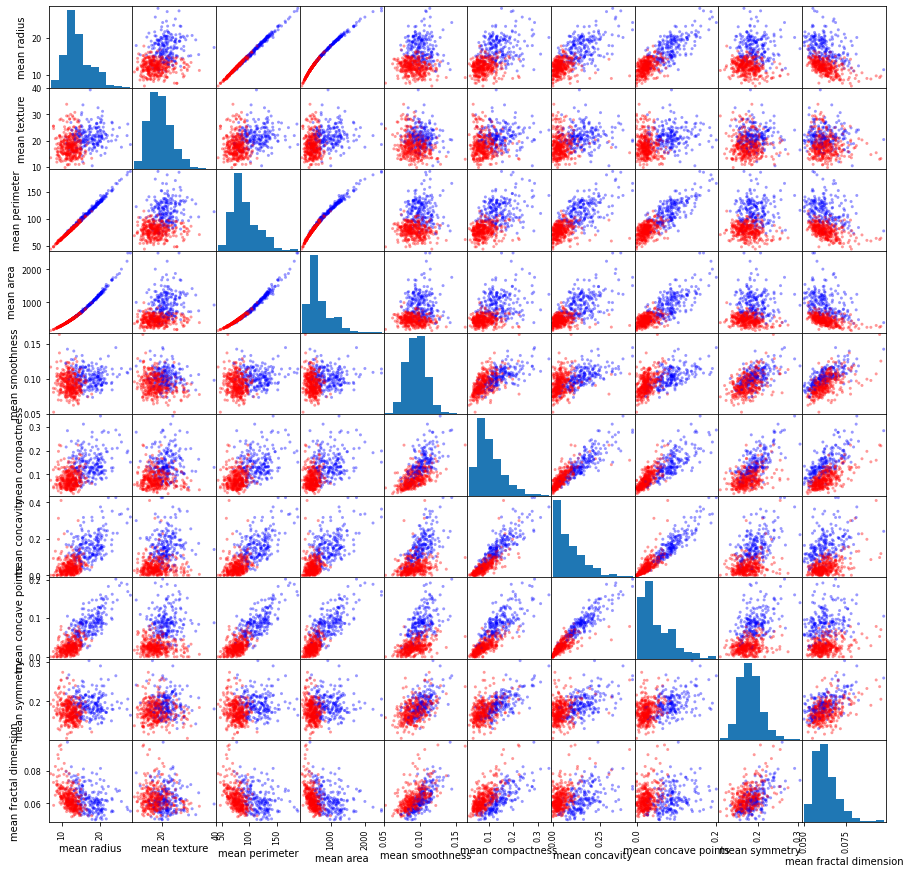

In [6]:
features_mean= list(df.columns[0:10])

color_dic = {1:'red', 0:'blue'}
colors = df['target'].map(lambda x: color_dic.get(x))

sm = pd.plotting.scatter_matrix(df[features_mean], c=colors, alpha=0.4, figsize=((15,15)));

plt.show()

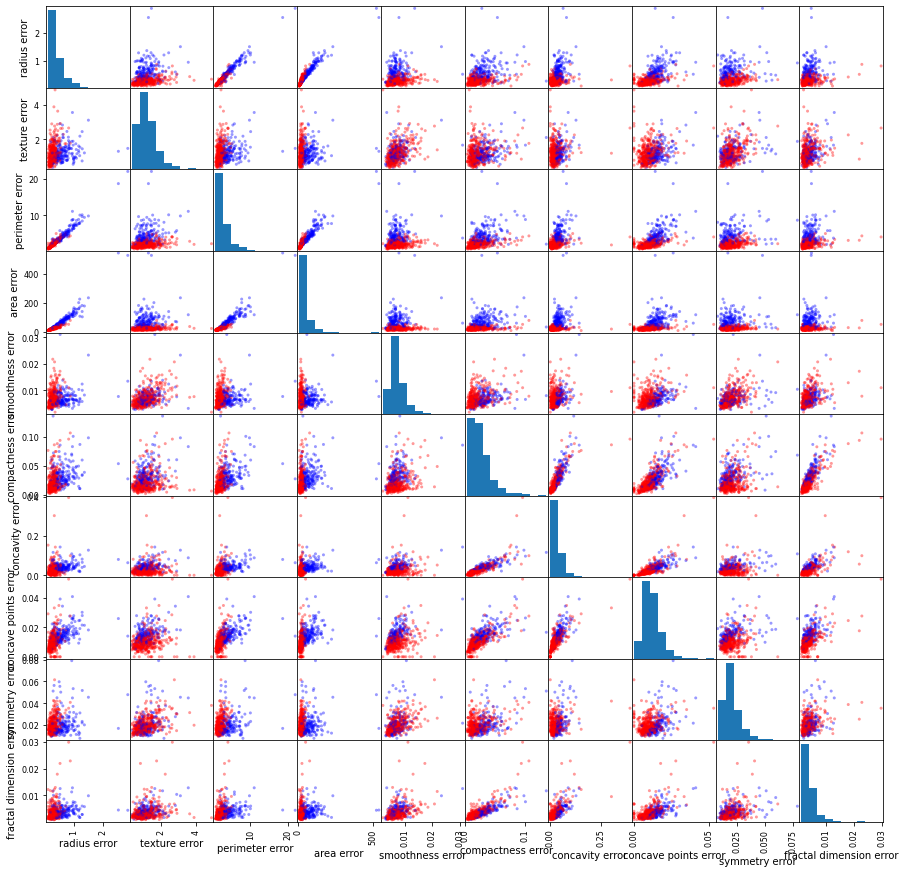

In [7]:
features_error= list(df.columns[10:20])

color_dic = {1:'red', 0:'blue'}
colors = df['target'].map(lambda x: color_dic.get(x))

sm = pd.plotting.scatter_matrix(df[features_error], c=colors, alpha=0.4, figsize=((15,15)));

plt.show()

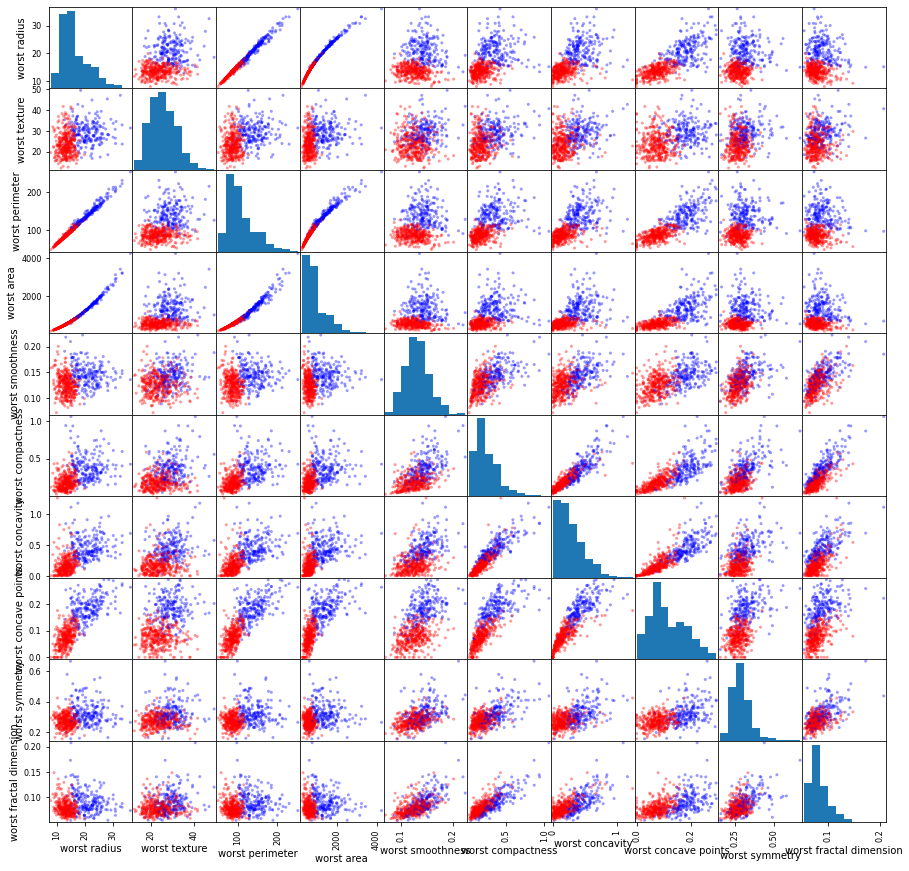

In [8]:
features_worst= list(df.columns[20:30])

color_dic = {1:'red', 0:'blue'}
colors = df['target'].map(lambda x: color_dic.get(x))

sm = pd.plotting.scatter_matrix(df[features_worst], c=colors, alpha=0.4, figsize=((15,15)));

plt.show()

In [7]:
col_std = np.std(df[df['target']==0])/np.std(df[df['target']==1]) > 2
dfstd = df[col_std.index[col_std]]
dfstd_pp = pd.Series(data=list(stats.ttest_ind(dfstd[df['target']==0],dfstd[df['target']==1],equal_var=False).pvalue),index=list(dfstd.columns))
dfstd = df[col_std.index[~col_std]]
dfstd_pm = pd.Series(data=list(stats.ttest_ind(dfstd[df['target']==0],dfstd[df['target']==1],equal_var=True).pvalue),index=list(dfstd.columns))

print(dfstd_pp[dfstd_pp > 0.05].index)
print(dfstd_pm[dfstd_pm > 0.05].index)

Index([], dtype='object')
Index(['mean fractal dimension', 'texture error', 'smoothness error',
       'symmetry error', 'fractal dimension error'],
      dtype='object')


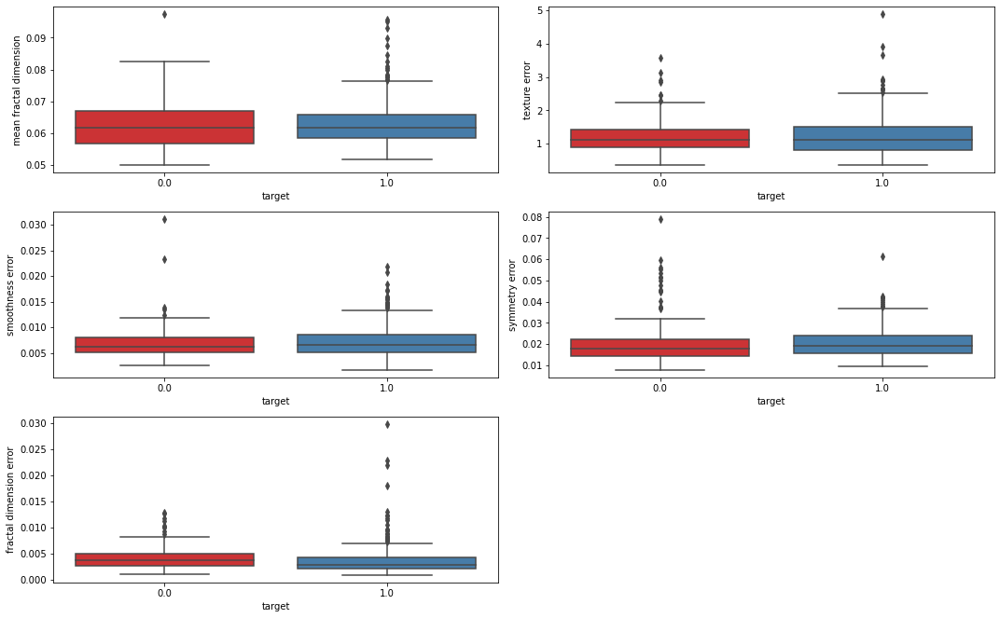

In [10]:
plt.figure(figsize=(15,15))
for i, feature in enumerate(list(dfstd_pm[dfstd_pm > 0.05].index)):
    
    plt.subplot(5, 2, i+1)    
    sns.boxplot(x='target', y=feature, data=df, palette="Set1")

plt.tight_layout()
plt.show()

# Modeling

## Prep data

In [5]:
robust_scaler = RobustScaler()

X = df.drop(columns=list(dfstd_pm[dfstd_pm > 0.05].index) + ['target'])
# Xtr = robust_scaler.fit_transform(X)

y = df.loc[:, 'target']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.2, random_state = 42)

## Model selection

In [14]:
mlflow.set_experiment('model_algo')


INFO: 'model_algo' does not exist. Creating a new experiment


In [15]:
scoring = {'acc': 'accuracy',
           'f1': 'f1',
           'roc': 'roc_auc'}

for algo in [GaussianNB(),KNeighborsClassifier(),RandomForestClassifier()]:
    # Useful for multiple runs (only doing one run in this sample notebook)    
    with mlflow.start_run(run_name=str(algo)):
        # Execute ElasticNet
        clf = algo
        clf.fit(X_train, y_train)

        # Evaluate Metrics
        prediction = clf.predict(X_test)
        acc = accuracy_score(prediction, y_test)
        scores = cross_validate(clf, X, y, scoring=scoring,
                            cv=5, return_train_score=True)

        # Log parameter, metrics, and model to MLflow
        # mlflow.log_param("alpha", alpha)
        # mlflow.log_param("l1_ratio", l1_ratio)
        mlflow.log_metric("accuracy", acc)
        mlflow.log_metric("accuray cross validation", np.mean(scores['test_acc']))
        mlflow.log_metric("f1 cross validation", np.mean(scores['test_f1']))
        mlflow.log_metric("ROC cross validation", np.mean(scores['test_roc']))


        mlflow.log_artifact(local_path = './exploration.ipynb')
        
        tracking_url_type_store = urlparse(mlflow.get_tracking_uri()).scheme

        # Model registry does not work with file store
        if tracking_url_type_store != "file":
            # Register the model
            mlflow.sklearn.log_model(clf, "model", registered_model_name= str(algo))
        else:
            mlflow.sklearn.log_model(clf, "model")

        mlflow.end_run()

## Parameter selection

In [8]:
mlflow.set_experiment('randomforest_param')

In [9]:
import pandas as pd
from sklearn import datasets
from sklearn import model_selection

In [10]:
from typing import Dict

import numpy as np
from sklearn import metrics

def regression_metrics(actual: pd.Series,
                       pred: pd.Series) -> Dict:
    """Return a collection of regression metrics as a Series.

    Args:
        actual: series of actual/true values
        pred: series of predicted values

    Returns:
        Series with the following values in a labeled index:
        MAE, RMSE
    """
    return {
        "ACCURACY": accuracy_score(actual,pred),
        "F1": metrics.f1_score(actual,pred)}

In [42]:
import mlflow
import mlflow.sklearn
from sklearn import model_selection 
from typing import Any
from typing import Dict
from typing import Union
from typing import Tuple

def fit_and_log_cv(x_train: Union[pd.DataFrame, np.array],
                   y_train: Union[pd.Series, np.array],
                   x_test: Union[pd.DataFrame, np.array],
                   y_test: Union[pd.Series, np.array],
                   params: Dict[str, Any],
                   nested: bool = False) -> Tuple[Dict[str, Any], Dict[str, Any]]:
  """Fit a model and log it along with train/CV metrics.
  
  Args:
      x_train: feature matrix for training/CV data
      y_train: label array for training/CV data
      x_test: feature matrix for test data
      y_test: label array for test data
      nested: if true, mlflow run will be started as child
          of existing parent
  """
  with mlflow.start_run(nested=nested) as run:
    # Fit CV models; extract predictions and metrics
    print(type(params))
    print(params)
    model_cv = RandomForestClassifier(**params)
    y_pred_cv = model_selection.cross_val_predict(model_cv, x_train, y_train)
    metrics_cv = {
      f"val_{metric}": value
      for metric, value in regression_metrics(y_train, y_pred_cv).items()}

    # Fit and log full training sample model; extract predictions and metrics
    mlflow.sklearn.autolog()
    model = RandomForestClassifier(**params)
    model.fit(X_train, y_train)
    y_pred_test = model.predict(x_test)
    metrics_test = {
      f"test_{metric}": value
      for metric, value in regression_metrics(y_test, y_pred_test).items()}
    
    metrics = {**metrics_test, **metrics_cv}
    mlflow.log_metrics(metrics)
    mlflow.sklearn.log_model(model, "model")
    return metrics

In [29]:
fit_and_log_cv(X_train,y_train,X_test,y_test,params={'n_estimators': 10,'criterion': 'gini'},nested=True)

<class 'dict'>
{'n_estimators': 10, 'criterion': 'gini'}


{'test_ACCURACY': 0.9473684210526315,
 'test_F1': 0.9583333333333334,
 'val_ACCURACY': 0.9560439560439561,
 'val_F1': 0.9647887323943661}

In [41]:
import hyperopt

def build_train_objective(x_train: Union[pd.DataFrame, np.array],
                          y_train: Union[pd.Series, np.array],
                          x_test: Union[pd.DataFrame, np.array],
                          y_test: Union[pd.Series, np.array],
                          metric: str):
    """Build optimization objective function fits and evaluates model.

    Args:
      x_train: feature matrix for training/CV data
      y_train: label array for training/CV data
      x_test: feature matrix for test data
      y_test: label array for test data
      metric: name of metric to be optimized
      
    Returns:
        Optimization function set up to take parameter dict from Hyperopt.
    """

    def train_func(params):
        """Train a model and return loss metric."""
        metrics = fit_and_log_cv(
          x_train, y_train, x_test, y_test, params, nested=True)
        return {'status': hyperopt.STATUS_OK, 'loss': -metrics[metric]}

    return train_func

In [21]:
def log_best(run: mlflow.entities.Run,
             metric: str) -> None:
    """Log the best parameters from optimization to the parent experiment.

    Args:
        run: current run to log metrics
        metric: name of metric to select best and log
    """

    client = mlflow.tracking.MlflowClient()
    runs = client.search_runs(
        [run.info.experiment_id],
        "tags.mlflow.parentRunId = '{run_id}' ".format(run_id=run.info.run_id))

    best_run = min(runs, key=lambda run: run.data.metrics[metric])

    mlflow.set_tag("best_run", best_run.info.run_id)
    mlflow.log_metric(f"best_{metric}", best_run.data.metrics[metric])

In [43]:
from hyperopt.pyll.base import scope
from hyperopt import Trials, hp

MAX_EVALS = 3
METRIC = "val_F1"

space = {
    'max_depth': hp.choice('max_depth', range(1,20)),
    'max_features': hp.choice('max_features', range(1,26)),
    'n_estimators': hp.choice('n_estimators', range(100,500)),
    'criterion': hp.choice('criterion', ["gini", "entropy"])}

trials = Trials()
train_objective = build_train_objective(
  X_train, y_train, X_test, y_test, METRIC)

with mlflow.start_run() as run:
  hyperopt.fmin(fn=train_objective,
                space=space,
                algo=hyperopt.tpe.suggest,
                max_evals=MAX_EVALS,
                trials=trials)
  log_best(run, METRIC)
  search_run_id = run.info.run_id
  experiment_id = run.info.experiment_id

<class 'dict'>
{'criterion': 'gini', 'max_depth': 5, 'max_features': 13, 'n_estimators': 259}
<class 'dict'>
{'criterion': 'entropy', 'max_depth': 17, 'max_features': 2, 'n_estimators': 369}
<class 'dict'>
{'criterion': 'gini', 'max_depth': 17, 'max_features': 10, 'n_estimators': 242}
100%|██████████| 3/3 [00:58<00:00, 19.49s/trial, best loss: -0.9705372616984402]


In [32]:
client = mlflow.tracking.MlflowClient()
runs = client.search_runs([experiment_id],
                          f"tags.mlflow.parentRunId = '{search_run_id}' ")
# Extract metrics and parameters 
df_metrics = pd.DataFrame.from_records(
    [{"run_id": run.info.run_id, **run.data.metrics, **run.data.params} for run in runs])

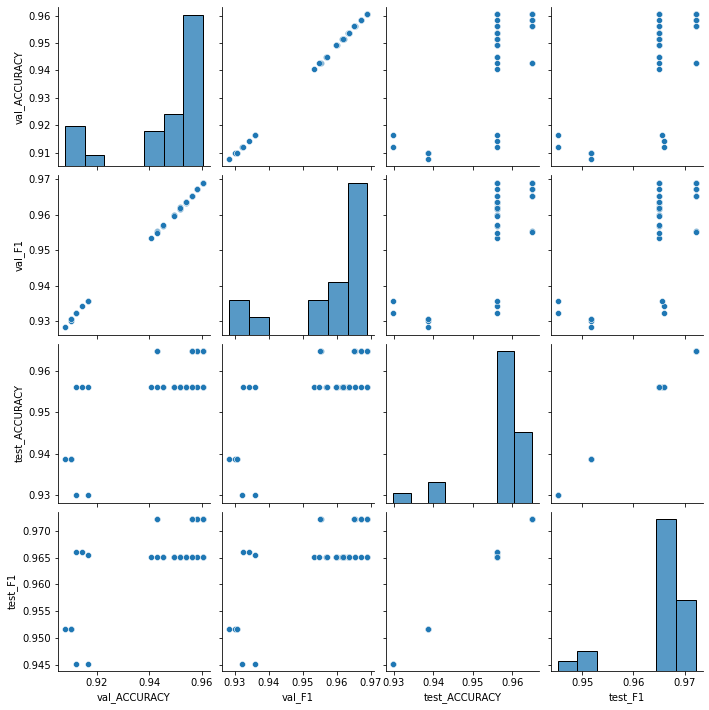

In [33]:
import seaborn

eval_metrics = ["val_ACCURACY", "val_F1", "test_ACCURACY", "test_F1"]
seaborn.pairplot(df_metrics[eval_metrics])

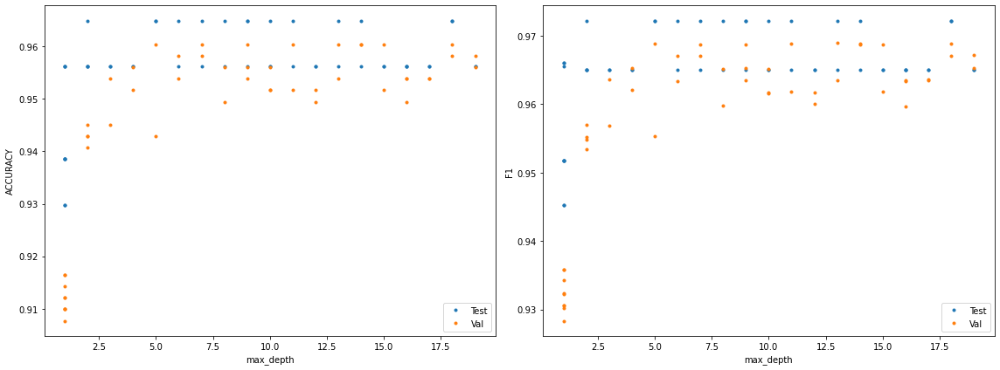

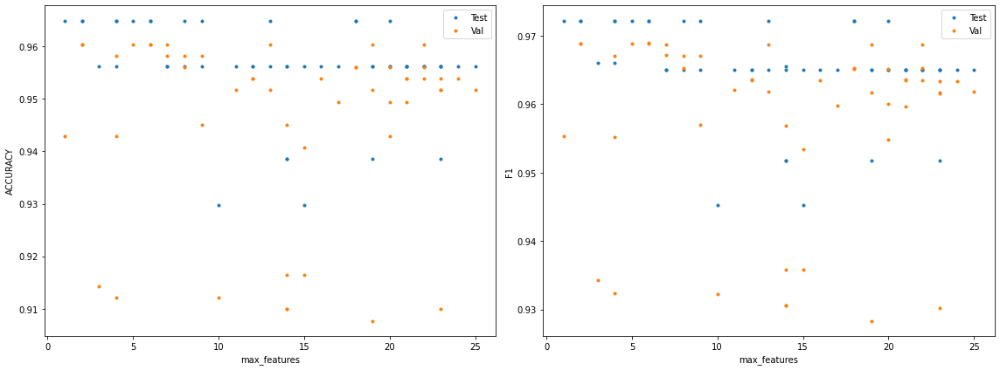

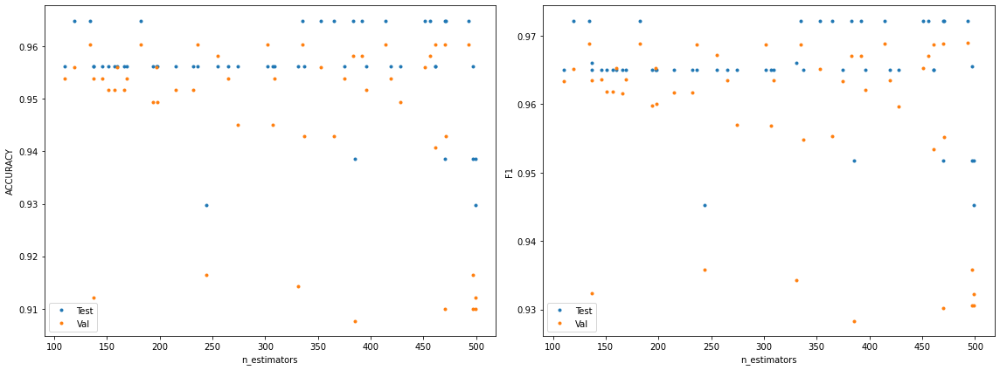

In [34]:
from matplotlib import pyplot as plt

# params = space.keys()
params = ['max_depth',
    'max_features',
    'n_estimators']
metric_names = ["ACCURACY", "F1"]

for param in params:
    fig = plt.figure(figsize=(16, 6))
    for pane, metric in enumerate(metric_names):
        plt.subplot(1, len(metric_names), pane + 1)
        plt.plot(
          df_metrics[param].astype(float), df_metrics[f"test_{metric}"],
          '.', label="Test")
        plt.plot(
          df_metrics[param].astype(float), df_metrics[f"val_{metric}"],
          '.', label="Val")
        plt.xlabel(param)
        plt.ylabel(metric)
        plt.legend()
    plt.tight_layout()

In [20]:
from hyperopt import fmin, hp, tpe

best = fmin(
    fn=lambda x: (x-1)**2,
    space=hp.uniform('x', -2, 2),
    algo=tpe.suggest,
    max_evals=200)

print(best)

100%|██████████| 200/200 [00:00<00:00, 239.46trial/s, best loss: 1.1424934669032642e-07]
{'x': 0.9996619920907873}


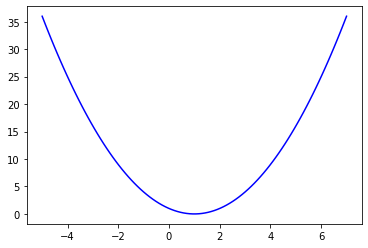

In [21]:
import matplotlib.pyplot as plt
import numpy as np

# 100 linearly spaced numbers
x = np.linspace(-5,7,100)

# the function, which is y = x^2 here
y = (x-1)**2

# setting the axes at the centre
fig = plt.figure()
ax = fig.add_subplot(1, 1, 1)

# plot the function
plt.plot(x,y, 'b')

# show the plot
plt.show()

In [29]:
from hyperopt import fmin, tpe, hp, STATUS_OK, Trials

fspace = {
    'x': hp.uniform('x', -5, 7)
}

def f(params):
    x = params['x']
    val = (x-1)**2
    return {'loss': val, 'status': STATUS_OK}

trials = Trials()
best = fmin(fn=f, space=fspace, algo=tpe.suggest, max_evals=1000, trials=trials)

print('best:', best)
print('trials:')

[print(trial) for trial in trials.trials[:2]]

100%|██████████| 1000/1000 [00:06<00:00, 160.91trial/s, best loss: 9.410071597251234e-07]
best: {'x': 1.000970055235399}
trials:
{'state': 2, 'tid': 0, 'spec': None, 'result': {'loss': 0.49155713063084827, 'status': 'ok'}, 'misc': {'tid': 0, 'cmd': ('domain_attachment', 'FMinIter_Domain'), 'workdir': None, 'idxs': {'x': [0]}, 'vals': {'x': [0.2988886460548166]}}, 'exp_key': None, 'owner': None, 'version': 0, 'book_time': datetime.datetime(2020, 11, 13, 20, 37, 42, 454000), 'refresh_time': datetime.datetime(2020, 11, 13, 20, 37, 42, 454000)}
{'state': 2, 'tid': 1, 'spec': None, 'result': {'loss': 14.698054232540395, 'status': 'ok'}, 'misc': {'tid': 1, 'cmd': ('domain_attachment', 'FMinIter_Domain'), 'workdir': None, 'idxs': {'x': [1]}, 'vals': {'x': [-2.83380414634608]}}, 'exp_key': None, 'owner': None, 'version': 0, 'book_time': datetime.datetime(2020, 11, 13, 20, 37, 42, 456000), 'refresh_time': datetime.datetime(2020, 11, 13, 20, 37, 42, 456000)}


[None, None]

Text(0, 0.5, '$x$')

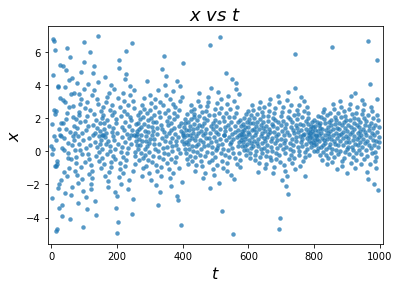

In [30]:
f, ax = plt.subplots(1)
xs = [t['tid'] for t in trials.trials]
ys = [t['misc']['vals']['x'] for t in trials.trials]
ax.set_xlim(xs[0]-10, xs[-1]+10)
ax.scatter(xs, ys, s=20, linewidth=0.01, alpha=0.75)
ax.set_title('$x$ $vs$ $t$ ', fontsize=18)
ax.set_xlabel('$t$', fontsize=16)
ax.set_ylabel('$x$', fontsize=16)

Text(0, 0.5, '$val$')

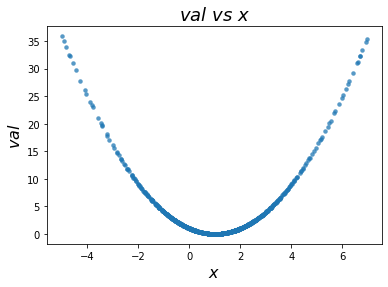

In [31]:
f, ax = plt.subplots(1)
xs = [t['misc']['vals']['x'] for t in trials.trials]
ys = [t['result']['loss'] for t in trials.trials]
ax.scatter(xs, ys, s=20, linewidth=0.01, alpha=0.75)
ax.set_title('$val$ $vs$ $x$ ', fontsize=18)
ax.set_xlabel('$x$', fontsize=16)
ax.set_ylabel('$val$', fontsize=16)